In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import psycopg2
import re


In [23]:
# connection to database:
try:
    conn = psycopg2.connect("dbname='spatial' user='postgres' host='localhost' password='na fam'")
except:
    print("cant connect to the database")

In [3]:
cur = conn.cursor()

In [4]:
#Query table from sales_analysis 
sql = 'select * from volusia.sales_analysis;'
df = pd.read_sql_query(sql, conn)
df = df.dropna()

In [5]:
df.head()

,parid,luc,luc_desc,aprland,aprbldg,aprtot,nbhd,sale_date,price,zip1,rmbed,sfla,total_area,yrblt,misc_area,months_since_sale,geom,water_front,has_pool
0,2665386.0,0100,Single Family,24000.0,144322.0,168322.0,5659,2020-04-29,180000.0,32725,4.0,1466.0,3184.0,1978.0,424.0,10,0106000020BC080000010000000103000000010000000B...,0,1
1,2665521.0,0100,Single Family,25092.0,177883.0,202975.0,5659,2017-04-28,210000.0,32725,3.0,1970.0,2518.0,1981.0,306.0,46,0106000020BC0800000100000001030000000100000019...,0,1
2,2906723.0,0100,Single Family,24000.0,143918.0,167918.0,5653,2018-05-07,195000.0,32725,3.0,1749.0,2465.0,1997.0,0.0,34,0106000020BC0800000100000001030000000100000008...,0,0
3,3774477.0,0100,Single Family,40000.0,98532.0,138532.0,3127,2018-06-15,159500.0,32127,2.0,1190.0,1376.0,1979.0,0.0,32,0106000020BC0800000100000001030000000100000007...,0,0
4,3774485.0,0100,Single Family,40000.0,98532.0,138532.0,3127,2017-09-29,156500.0,32127,2.0,1190.0,1376.0,1979.0,0.0,41,0106000020BC0800000100000001030000000100000007...,0,0


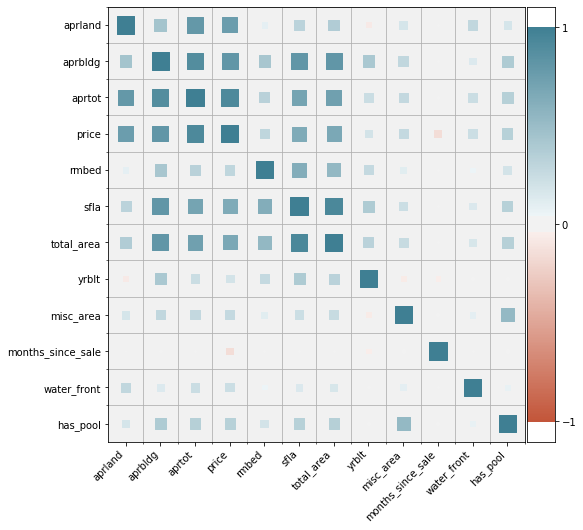

In [6]:
#Visualizing correlations using heatmap library
#Could use functions to do this. By why work hard?
# !pip install heatmapz
#Selecting columns that make sense
columns = ['luc_desc', 'aprland', 'aprbldg', 'aprtot', 'nbhd', 'sale_date', 'price', 'zip1', 'rmbed', 'sfla', 'total_area', 'yrblt', 'misc_area', 'months_since_sale', 'water_front', 'has_pool']
from heatmap import heatmap, corrplot
plt.figure(figsize=(8,8))
corrplot(df[columns].corr(), size_scale=300)


In [7]:
#---get the top 3 features that has the highest correlation---
print(df[columns].corr().abs().nlargest(3, 'price').index)

#---print the top 3 correlation values---
print(df[columns].corr().abs().nlargest(3, 'price').values[:,3])

Index(['price', 'aprtot', 'aprbldg'], dtype='object')
[1.         0.92791652 0.81933783]


Text(0, 0.5, 'price')

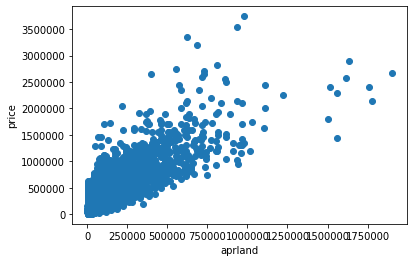

In [8]:
%matplotlib inline

plt.scatter(df['aprland'], df['price'], marker='o')
plt.xlabel('aprland')
plt.ylabel('price')

Text(0, 0.5, 'price')

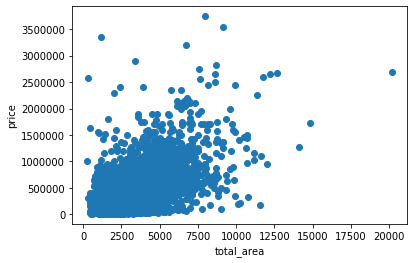

In [9]:
%matplotlib inline

plt.scatter(df['total_area'], df['price'], marker='o')
plt.xlabel('total_area')
plt.ylabel('price')

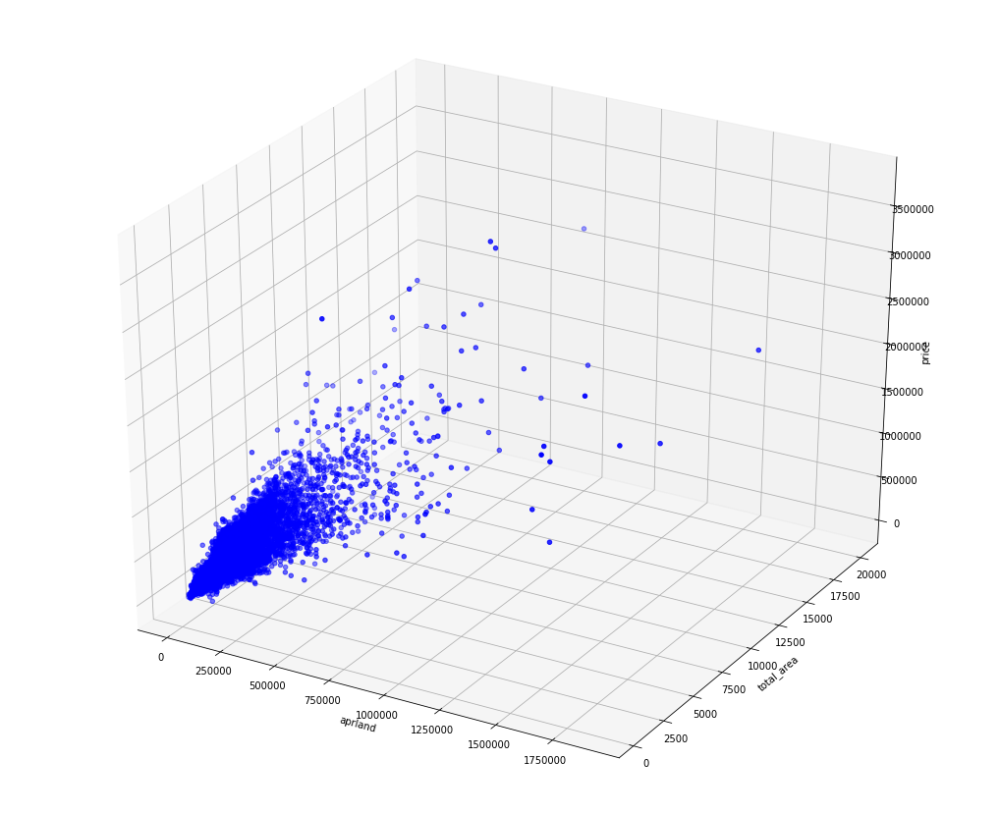

In [10]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(18,15))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aprland'],
           df['total_area'],
           df['price'],
           c='b')

ax.set_xlabel("aprland")
ax.set_ylabel("total_area")
ax.set_zlabel("price")
plt.show()

In [11]:
x = pd.DataFrame(np.c_[df['total_area'], df['aprland']], columns = ['total_area','aprland'])
Y = df['price']

In [12]:
from sklearn.model_selection import train_test_split
x_train, x_test, Y_train, Y_test = train_test_split(x, Y, test_size = 0.3,
                                                    random_state=5)

In [13]:
print(x_train.shape)
print(Y_train.shape)

(32358, 2)
(32358,)


In [14]:
print(x_test.shape)
print(Y_test.shape)

(13868, 2)
(13868,)


In [15]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(x_train, Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [16]:
print('R-squared: %.4f' % model.score(x_test,
                                      Y_test))


R-squared: 0.7494


5714681986.57897


Text(0.5, 1.0, 'Actual prices vs Predicted prices')

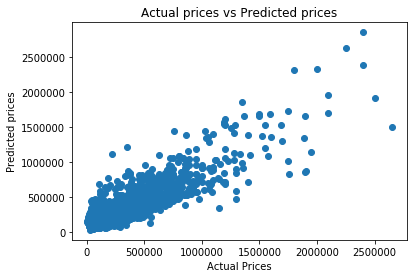

In [17]:
from sklearn.metrics import mean_squared_error
price_pred = model.predict(x_test)
mse = mean_squared_error(Y_test, price_pred)
print(mse)

plt.scatter(Y_test, price_pred)
plt.xlabel("Actual Prices")
plt.ylabel("Predicted prices")
plt.title("Actual prices vs Predicted prices")